In [2]:
import numpy as np
import matplotlib.pyplot as plt
import librosa

In [14]:
# Read .wav file containing audio.
audio_data, sample_rate = librosa.load('DEJU.wav',sr=None)
#audio_data, sample_rate = librosa.load('PSFL.wav',sr=None)
#audio_data, sample_rate = librosa.load('SPTO.wav',sr=None)
#audio_data, sample_rate = librosa.load('WAVI.wav',sr=None)
# audio_data, sample_rate = librosa.load('WIWA.wav',sr=None)

print('sample rate = '+repr(sample_rate))
length_sec = len(audio_data) / sample_rate
print('length = '+repr(length_sec)+' sec')

sample rate = 44100
length = 15.0 sec


In [ ]:
from scipy import signal
# Let's compute the spectrgram of the full length signal.
# Create window.

# Window size in samples.
window_length = 1024

# Window overlap in samples.
# A 50% overlap would be window_length/2.
window_overlap = int(window_length / 4)

# Window type (shape).
win = signal.get_window('boxcar', window_length)
#win = signal.get_window('hann', window_length)

w, t, s = signal.spectrogram(audio_data, sample_rate, window=win, noverlap=window_overlap, nperseg=window_length)

# s: matrix with the 2D spectrogram (will be complex).
# w: vector with the frequencies spacings of the computed DFT.
# t: vector with the time spacings of the windows.

# Compute the spectrum of the spectrogram.
s_spectrum = abs(s);

print('spectrogram has size: ', s_spectrum.shape)

spectrogram has size:  (513, 645)


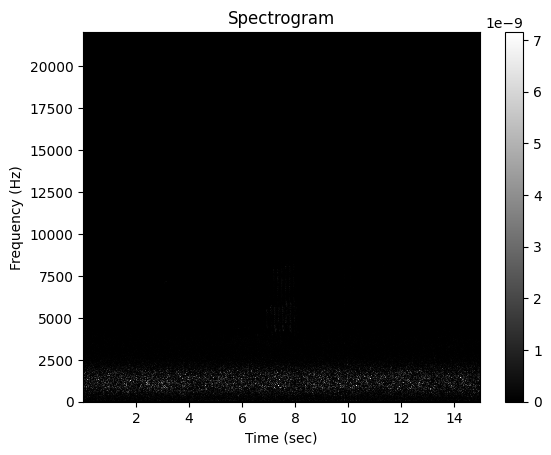

In [5]:
# Plot the spectrogram.

# Calculate the extent of the x and y axes.
extent_tf = (t[0], t[-1], w[0], w[-1])

# Plot the spectrogram in grayscale.
plt.imshow(s_spectrum, origin='lower', aspect='auto', extent=extent_tf, interpolation='none', cmap='gray')
plt.xlabel("Time (sec)")
plt.ylabel("Frequency (Hz)")
plt.title("Spectrogram")
plt.colorbar()
plt.show()

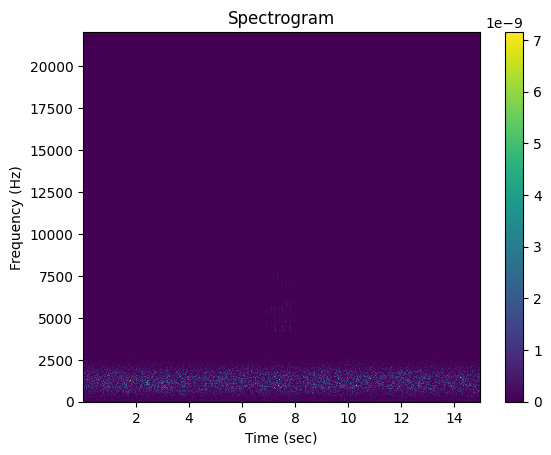

In [6]:
# Plot the spectrogram using default colormap ('viridis').
plt.imshow(s_spectrum, origin='lower', aspect='auto', extent=extent_tf, interpolation='none')
plt.xlabel("Time (sec)")
plt.ylabel("Frequency (Hz)")
plt.title("Spectrogram")
plt.colorbar()
plt.show()

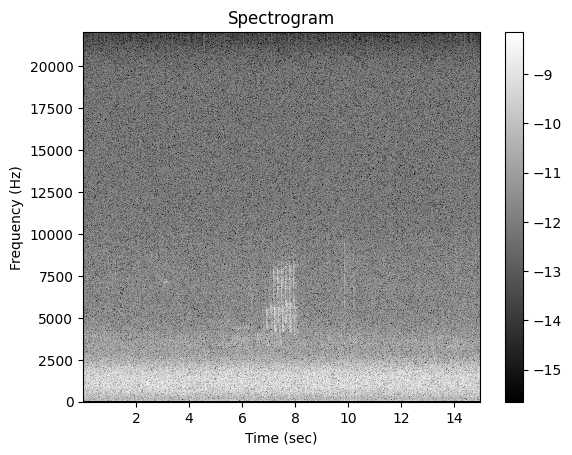

In [24]:
# Plot the log of the spectrum of the spectrogram.
s_spectrum_log = np.log10( s_spectrum + np.finfo(float).eps )

# Plot in grayscale.
plt.imshow(s_spectrum_log, origin='lower', aspect='auto', extent=extent_tf, interpolation='none', cmap='gray')
plt.xlabel("Time (sec)")
plt.ylabel("Frequency (Hz)")
plt.title("Spectrogram")
plt.colorbar()
plt.savefig('figure_spectrogram_log.png', dpi=300, bbox_inches='tight')
plt.show()

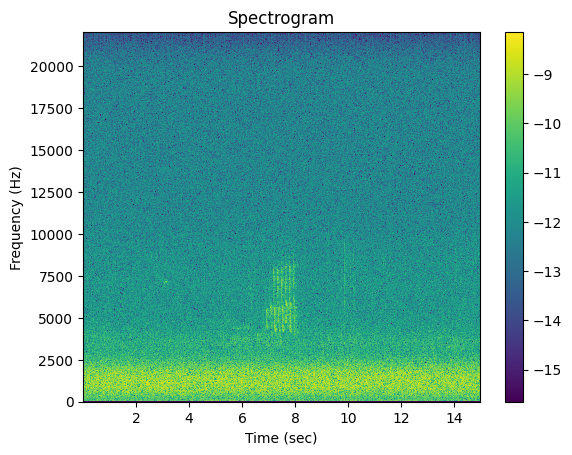

In [25]:
# Plot using default colormap ('viridis').
plt.imshow(s_spectrum_log, origin='lower', aspect='auto', extent=extent_tf, interpolation='none' )
plt.xlabel("Time (sec)")
plt.ylabel("Frequency (Hz)")
plt.title("Spectrogram")
plt.colorbar()
plt.show()

In [26]:
# Save log of spectrogram image as a .png file

# Normalize so values range from 0 to 1.
s_spectrum_log = (s_spectrum_log - np.amin(s_spectrum_log)) / (np.amax(s_spectrum_log) - np.amin(s_spectrum_log))

# Flip it vertically.
s_spectrum_log = np.flip(s_spectrum_log, 0)

# Save as png file.
spectrogram_filename = 'spectrogram_log.png'
plt.imsave(spectrogram_filename, s_spectrum_log, cmap='gray')

In [52]:
def process_spectrogram(audio_data, sample_rate, window_length, percentage_overlap, window_type, file_name):
    import numpy as np
    import matplotlib.pyplot as plt
    from scipy import signal

    # Compute window overlap.
    # For example, if window_length is 1024 and percentage_overlap is 50, 
    # then window_overlap will be int(1024 * 50/100) = 512.
    window_overlap = int(window_length * (percentage_overlap / 100.0))
    
    # Translate window_type:
    # If 'box' is provided, use 'boxcar' for the scipy window.
    win_str = 'boxcar' if window_type.lower() == 'box' else window_type
    
    # Create window.
    win = signal.get_window(win_str, window_length)
    
    # Compute spectrogram.
    w, t, s = signal.spectrogram(audio_data, sample_rate, window=win, noverlap=window_overlap, nperseg=window_length)
    
    # Compute magnitude spectrogram.
    s_spectrum = np.abs(s)
    
    print('sample rate = ' + repr(sample_rate))
    length_sec = len(audio_data) / sample_rate
    print('length = ' + repr(length_sec) + ' sec')
    print('spectrogram has size: ', s_spectrum.shape)
    
    # Calculate the extent for axes.
    extent_tf = (t[0], t[-1], w[0], w[-1])
    
    # Plot the spectrogram in grayscale.
    plt.figure()
    plt.imshow(s_spectrum, origin='lower', aspect='auto', extent=extent_tf, interpolation='none', cmap='gray')
    plt.xlabel("Time (sec)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Spectrogram (gray)")
    plt.colorbar()
    # plt.show()
    
    # Plot using the default colormap ('viridis').
    plt.figure()
    plt.imshow(s_spectrum, origin='lower', aspect='auto', extent=extent_tf, interpolation='none')
    plt.xlabel("Time (sec)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Spectrogram (viridis)")
    plt.colorbar()
    # plt.show()
    
    # Compute the log of the spectrogram.
    s_spectrum_log = np.log10(s_spectrum + np.finfo(float).eps)
    
    # Plot the log-spectrogram in grayscale and save as a figure.
    plt.figure()
    plt.imshow(s_spectrum_log, origin='lower', aspect='auto', extent=extent_tf, interpolation='none', cmap='gray')
    plt.xlabel("Time (sec)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Log-Spectrogram (gray)")
    plt.colorbar()
    # Create filename including the used parameters.
    spectrogram_filename = f'./{file_name}/figure_spectrogram_log_{window_length}_{percentage_overlap}_{window_type}.png'
    plt.savefig(spectrogram_filename, dpi=300, bbox_inches='tight')
    # plt.show()
    
    # Plot the log-spectrogram with default colormap.
    plt.figure()
    plt.imshow(s_spectrum_log, origin='lower', aspect='auto', extent=extent_tf, interpolation='none')
    plt.xlabel("Time (sec)")
    plt.ylabel("Frequency (Hz)")
    plt.title("Log-Spectrogram (viridis)")
    plt.colorbar()
    # plt.show()
    
    # Normalize so values range from 0 to 1.
    s_spectrum_log = (s_spectrum_log - np.amin(s_spectrum_log)) / (np.amax(s_spectrum_log) - np.amin(s_spectrum_log))

    # Flip it vertically.
    s_spectrum_log = np.flip(s_spectrum_log, 0)

    spectrogram_filename = f'./{file_name}/spectrogram_log_{window_length}_{percentage_overlap}_{window_type}.png'

    # Save the log-spectrogram image using imsave.
    plt.imsave(spectrogram_filename, s_spectrum_log, cmap='gray')

sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 1015)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 1015)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 1015)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 1353)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 1353)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 1353)


/var/folders/zm/xq3n3cqd18d23lp_0b03ljyh0000gn/T/ipykernel_39939/1272005508.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 2029)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 2029)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 2029)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 4057)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 4057)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (257, 4057)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (513, 507)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (513, 507)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (513, 507)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (513, 676)
sample rate = 44100
length = 11.785714285714286 sec
spectrogram has size:  (513, 676)
sample rate = 44100
length = 11.785714285714286 

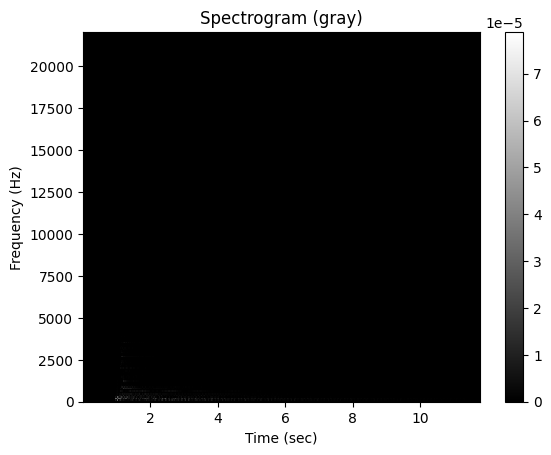

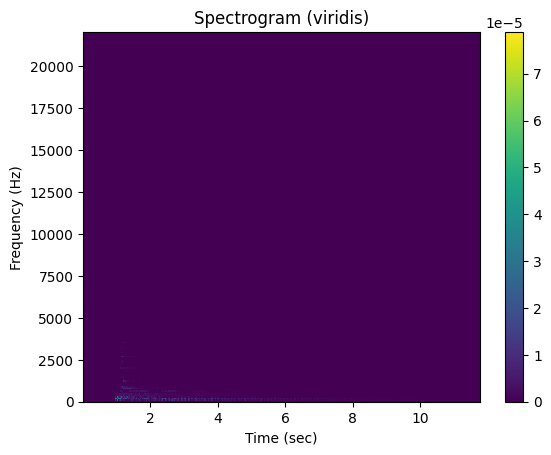

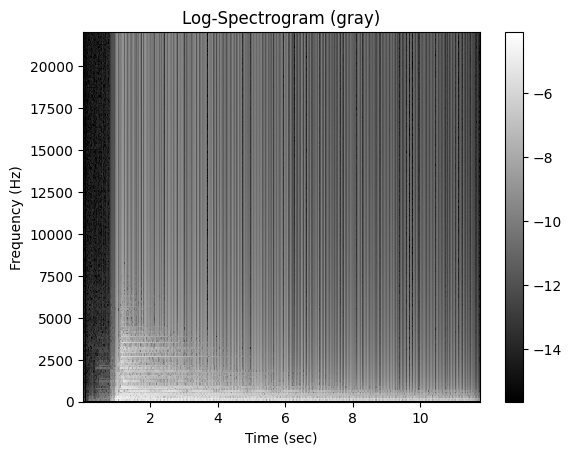

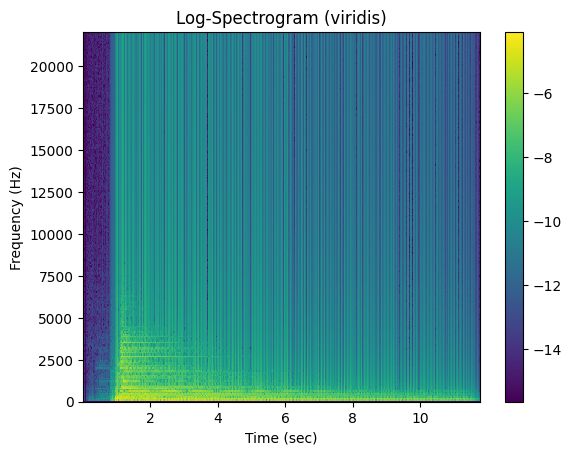

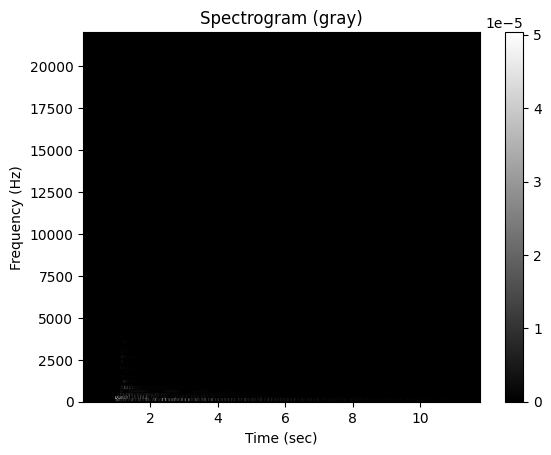

...

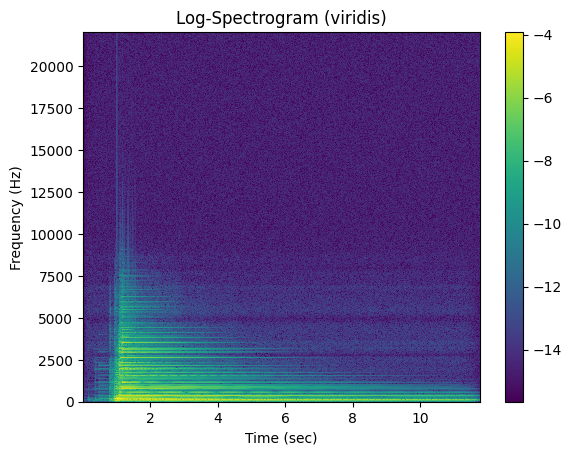

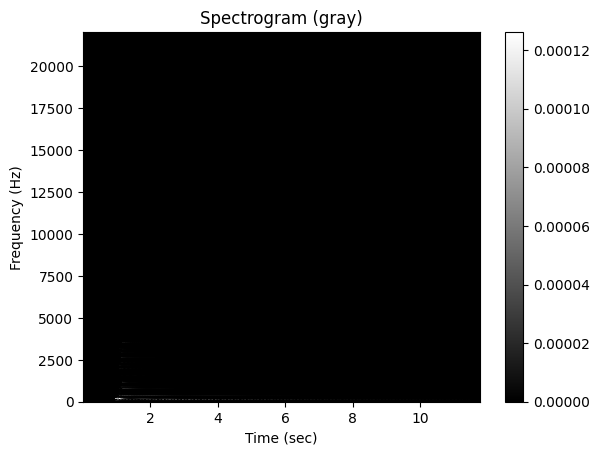

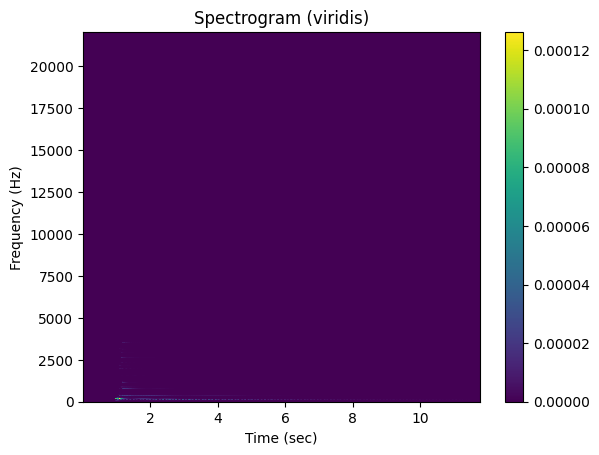

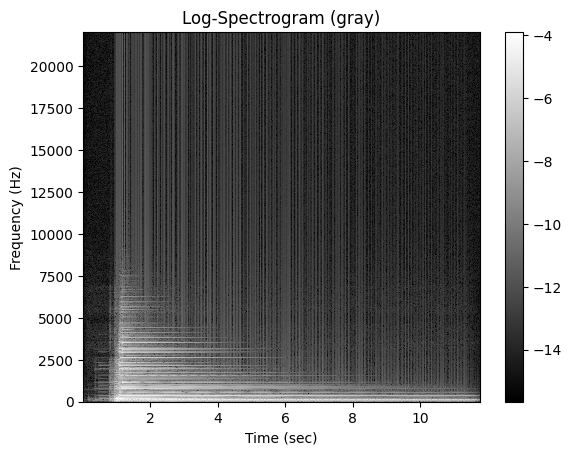

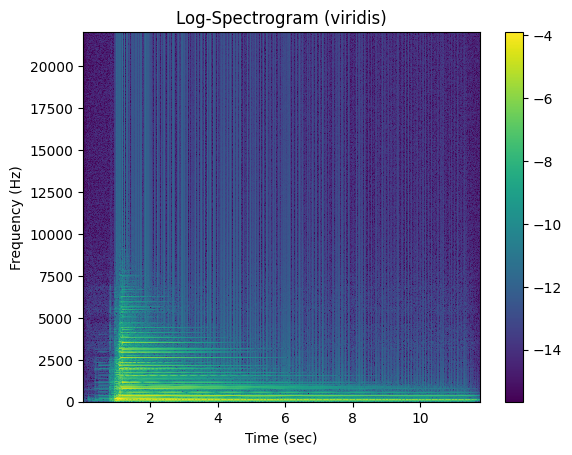

In [58]:

# audio_data, sample_rate = librosa.load('DEJU.wav',sr=None)
# audio_data, sample_rate = librosa.load('PSFL.wav',sr=None)
# audio_data, sample_rate = librosa.load('SPTO.wav',sr=None)
# audio_data, sample_rate = librosa.load('WAVI.wav',sr=None)
audio_data, sample_rate = librosa.load('guitar-chord-g-major.wav',sr=None)

for window_length in [512, 1024, 2048]:
    for percentage_overlap in [0, 25, 50, 75]:
        for window_type in ['box', 'hann', 'hamming']:
            process_spectrogram(audio_data, 
                                sample_rate, 
                                window_length, 
                                percentage_overlap, 
                                window_type, 
                                'g-major')